nbviewer.jupyter.org/format/slides/gist/leechanwoo/

In [1]:
from IPython.display import Image

# Deep Learning Day 8.

## Word2vec
 * Concept
 * Code Review

### Concept

 * one hot encoding 시 vector size가 매우 크고 sparse 하므로 neural net 성능이 잘 나오지 않는다.
 * "주위 단어가 비슷하면 해당 단어의 의미는 유사하다" 라는 아이디어
 * 단어를 트레이닝 시킬 때 주위 단어를 label로 매치하여 최적화
 * 단어를 "의미를 내포한 dense vector"로 매칭 시키는 것이 목표!

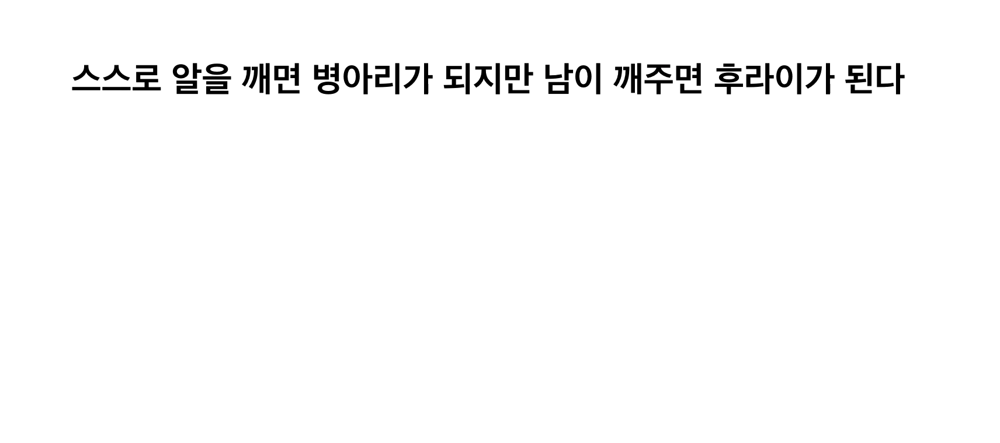

In [2]:
Image('./day8/skip_gram.gif.png')
## train data = 빨간색
## label = 파란색 
## 이렇게 매치 시켜서 트레이닝함 

#### embeddings 

 * dataset으로 구성된 words를 Multi-layer perceptron을 이용하여 학습
 * input layer의 weight에 해당하는 Matrix가 학습이 완료되면 embeddings(vector dictionary) 완성
 
 - input data의 크기는 output data의 크기와 같아야 함 , hidden layer는 사용자 정의 
 - hyperparameter = softmax로 하여 퍼센테이지 제일 큰 label 선택(outmax?함수 사용)  
 - id_map을 이용하여 문장의 단어들을 벡터로 바꿔줌, index를 받음 
 - 단어의 개수가 100~200개가 효과가 제일 좋음, 결과가 잘 나타남
 - embeddings 가 있어야함 
 - jason으로 key, value 맵핑 
 - projection = one-hot-encoding으로 숫자 하나 하나 바꾸는것이 아니라 단어에 해당하는 id에 매치된 숫자를 바로 빼냄 

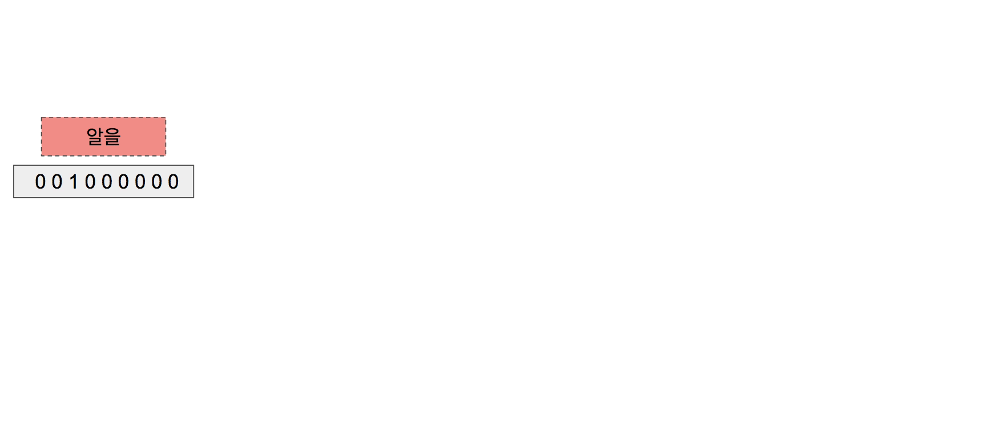

In [3]:
Image('./day8/word_embedding.gif.png')

1. Word Embedding이란 무엇입니까?
매우 단순한 용어로 Word Embedding은 텍스트를 숫자로 변환한 것으로 동일한 텍스트에 대해 다른 숫자로 표현할 수 있습니다. 그러나 Word Embeddings에 대한 자세한 내용을 알아보기 전에 다음 질문을 해야합니다. - Word Embedding이 필요한 이유는 무엇입니까?
결과적으로 많은 머신러닝 알고리즘과 거의 모든 딥러닝 아키텍처는 원시 형식의 문자열이나 일반 텍스트를 처리 할 수 ​​없습니다. 그들은 일종의 직업을 수행하기 위해 입력으로 숫자를 요구합니다. 이것은 분류, 회귀 등 넓은 의미에서 필요합니다. 그리고 텍스트 형식으로 제공되는 방대한 양의 데이터로 지식을 추출하고 응용 프로그램을 작성하는 것이 중요합니다. 텍스트 응용 프로그램의 실제 응용 프로그램에는 Amazon 등의 리뷰 감정 분석, 문서 또는 뉴스 분류 또는 Google의 클러스터링 등이 있습니다.
Word Embedding을 정식으로 정의하겠습니다. Word Embedding 형식은 일반적으로 사전을 사용하여 단어를 벡터에 매핑하려고 시도합니다. 이 문장을보다 세세한 부분까지 세분화하여 명확한 시각을 갖도록합니다.
 
이 예제를 보세요. - 문장 = "Word Embedding은 숫자로 변환 된 Word"
이 문장의 단어 는 "Embeddings"또는 "numbers"등일 수 있습니다.
사전의 모든 고유 단어의 목록이 될 수 있습니다. 그래서, 사전은 - 'Word', 'Embeddings', 'are', 'Converted', 'into', 'numbers'와 같이 보입니다.
위의 사전에 따 른이 형식의 "숫자"의 벡터 표현 은 [0,0,0,0,0,1]이고 변환된 값은 [0,0,0,1,0,0]입니다.
이것은 벡터 형태로 단어를 표현하는 아주 간단한 방법 일뿐입니다. Word Embedding 또는 Word Vectors의 여러 유형과 그 나머지의 장점과 단점을 살펴 보겠습니다.
 
 
2. Word Embedding의 다른 유형
다양한 유형의 단어 삽입은 크게 두가지 범주로 분류 할 수 있습니다.
주파수 기반 임베딩
예측 기반 임베딩
이 방법들 각각을 자세히 이해하도록 노력합시다.
 
2.1 주파수 기반 임베딩
일반적으로이 범주에서 우리가 접하게되는 세가지 유형의 벡터가 있습니다.
카운트 벡터
TF-IDF 벡터
동시 발생 벡터
이러한 각 벡터화 방법을 자세히 살펴 보겠습니다.
 
2.1.1 카운트 벡터
코퍼스 C에서 추출된 코퍼스 C 문서 D {d1, d2 ... ..dD}와 N개의 고유 토큰을 고려하십시오. N 토큰은 사전을 구성 할 것이며 카운트 벡터 행렬 M의 크기는 DX N에 의해 ​​주어질 것입니다. 행렬 M의 각 행은 문서 D(i)의 토큰 빈도를 포함합니다.

https://www.nextobe.com/single-post/2017/06/20/Word-Embedding%EC%9D%98-%EC%A7%81%EA%B4%80%EC%A0%81%EC%9D%B8-%EC%9D%B4%ED%95%B4-Count-Vector%EC%97%90%EC%84%9C-Word2Vec%EC%97%90-%EC%9D%B4%EB%A5%B4%EA%B8%B0%EA%B9%8C%EC%A7%80

### Code review

source: https://github.com/tensorflow/tensorflow/blob/r1.3/tensorflow/examples/tutorials/word2vec/word2vec_basic.py

## nce = cross entropy 연산량이 많아서 트릭쓴 것 
## nce loss 
* 

https://www.tensorflow.org/tutorials/word2vec#scaling_up_with_noise-contrastive_training

In [ ]:
 embeddings = tf.Variable(
        tf.random_uniform([vocabulary_size, embedding_size], -1.0, 1.0))
    embed = tf.nn.embedding_lookup(embeddings, train_inputs)

    # Construct the variables for the NCE loss
    nce_weights = tf.Variable(
        tf.truncated_normal([vocabulary_size, embedding_size],
                            stddev=1.0 / math.sqrt(embedding_size)))
    nce_biases = tf.Variable(tf.zeros([vocabulary_size]))

  # Compute the average NCE loss for the batch.
  # tf.nce_loss automatically draws a new sample of the negative labels each
  # time we evaluate the loss.
  loss = tf.reduce_mean(
      tf.nn.nce_loss(weights=nce_weights,
                     biases=nce_biases,
                     labels=train_labels,
                     inputs=embed,
                     num_sampled=num_sampled,
                     num_classes=vocabulary_size))

  # Construct the SGD optimizer using a learning rate of 1.0.
  optimizer = tf.train.GradientDescentOptimizer(1.0).minimize(loss)